In [56]:
import stlearn as st
import pandas as pd
from pathlib import Path
import shutil
from PIL import Image
import matplotlib 
from matplotlib import pyplot as plt
import numpy as np
from IPython.display import display

In [59]:
def thumbnail(img, size = (1000,1000)):
    """Converts Pillow images to a different size without modifying the original image
    """
    img_thumbnail = img.copy()
    img_thumbnail.thumbnail(size)
    return img_thumbnail

In [7]:
img_from_path = Path("/clusterdata/uqxtan9/Xiao/her2st/data/HER2_samples")
img_to_path = Path("/clusterdata/uqxtan9/Xiao/her2st/data/ST-imgs_hires")

In [8]:
samples = ["A", "B", "C", "D", "E", "F", "G", "H"]

In [12]:
img_from_list = []
for sample in samples:
    for img in img_from_path.glob("./{}/Patient*_HE.jpg".format(sample)):
        img_from_list.append(str(img))

In [15]:
img_from_list = sorted(img_from_list)

In [30]:
sample_id_new = []
sample_old = None
for img in img_from_list:
    sample_new = img.split("/")[-2]
    if sample_new == sample_old:
        i=i+1
    else:
        i=1
        sample_old = sample_new
    out_path = img_to_path / "{}{}_HE.jpg".format(sample_new,i)
    sample_id_new.append("{}{}".format(sample_new,i))
#     shutil.copy(img, out_path)

In [31]:
sample_id_new

['A1',
 'A2',
 'A3',
 'A4',
 'A5',
 'A6',
 'B1',
 'B2',
 'B3',
 'B4',
 'B5',
 'B6',
 'C1',
 'C2',
 'C3',
 'C4',
 'C5',
 'C6',
 'D1',
 'D2',
 'D3',
 'D4',
 'D5',
 'D6',
 'E1',
 'E2',
 'E3',
 'F1',
 'F2',
 'F3',
 'G1',
 'G2',
 'G3',
 'H1',
 'H2',
 'H3']

In [36]:
img_path = Path("/clusterdata/uqxtan9/Xiao/her2st/data/ST-imgs_hires")
spot_path = Path("/clusterdata/uqxtan9/Xiao/her2st/data/ST-spotfiles")
cm_path = Path("/clusterdata/uqxtan9/Xiao/her2st/data/ST-cnts")

In [42]:
img_lowres_path = Path("/clusterdata/uqxtan9/Xiao/her2st/data/ST-imgs")
img_lowres_new_path = Path("/clusterdata/uqxtan9/Xiao/her2st/data/ST-imgs_lowres")

In [44]:
for sample in sample_id_new:
    img_old_name = next(img_lowres_path.glob("./{}/*.jpg".format(sample)))
    img_new_name = img_lowres_new_path / "{}_HE.jpg".format(sample)
#     shutil.copy(img_old_name, img_new_name)

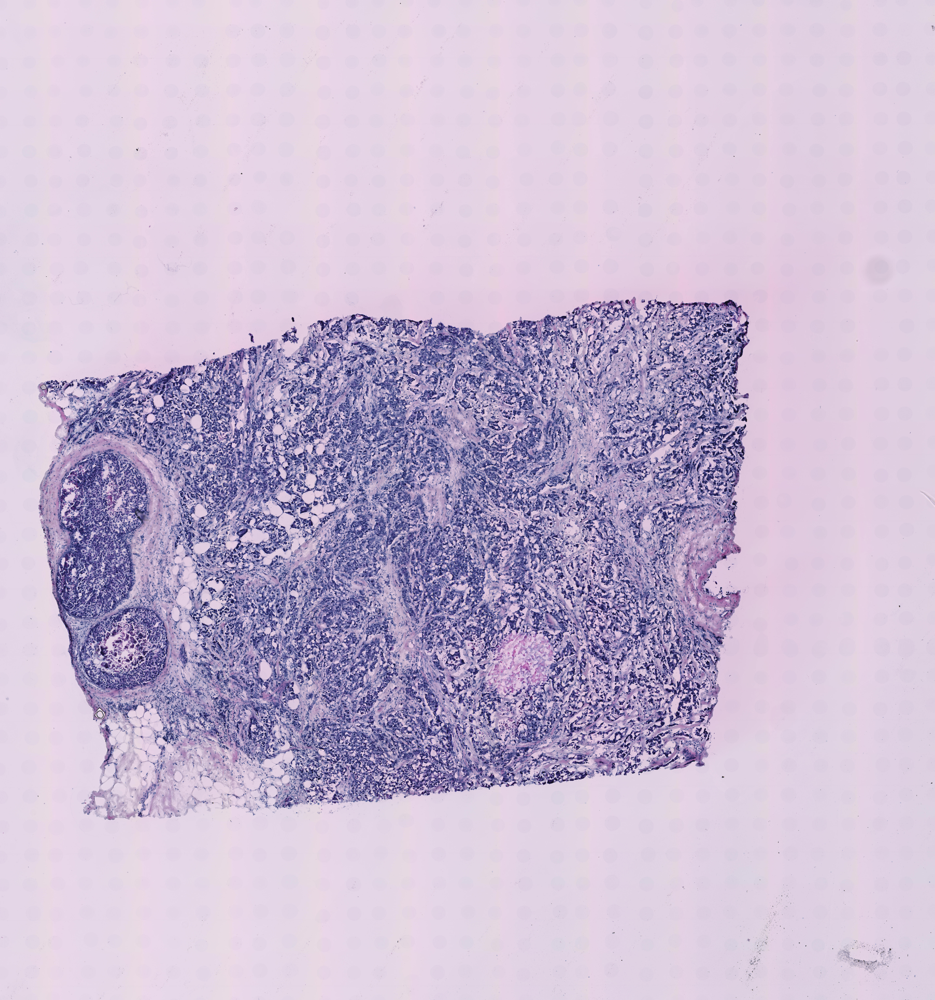

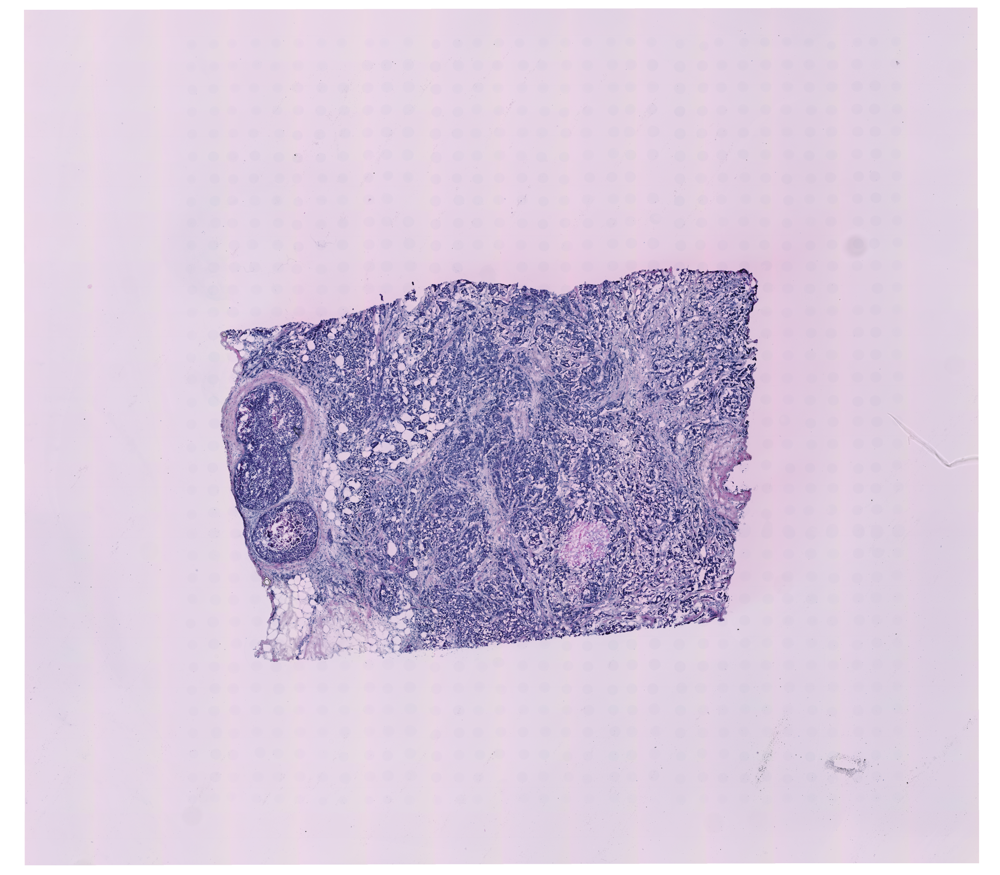

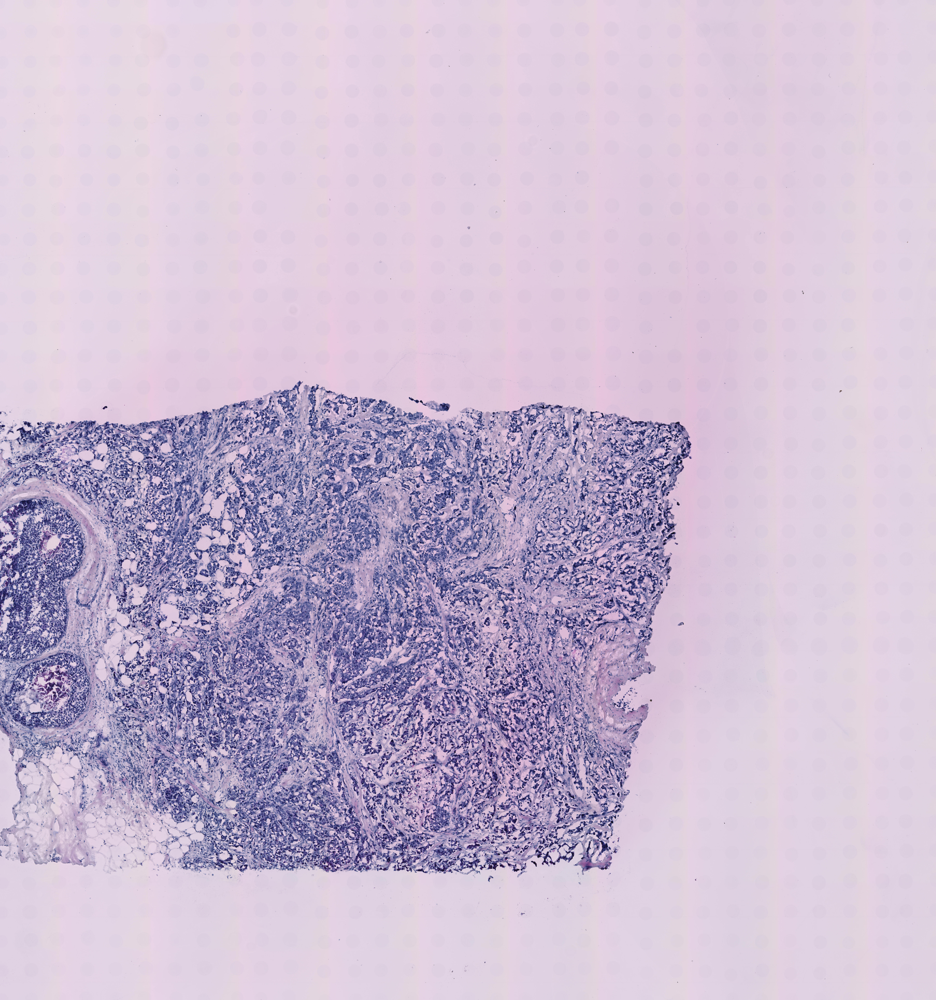

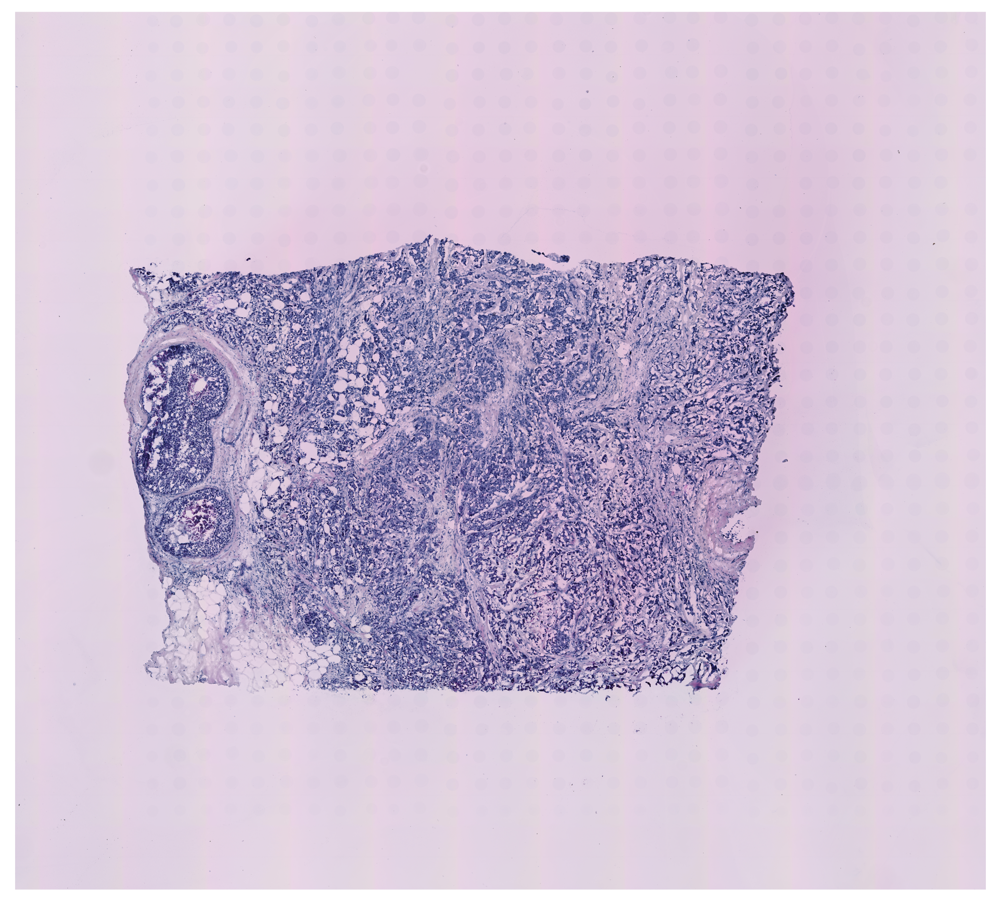

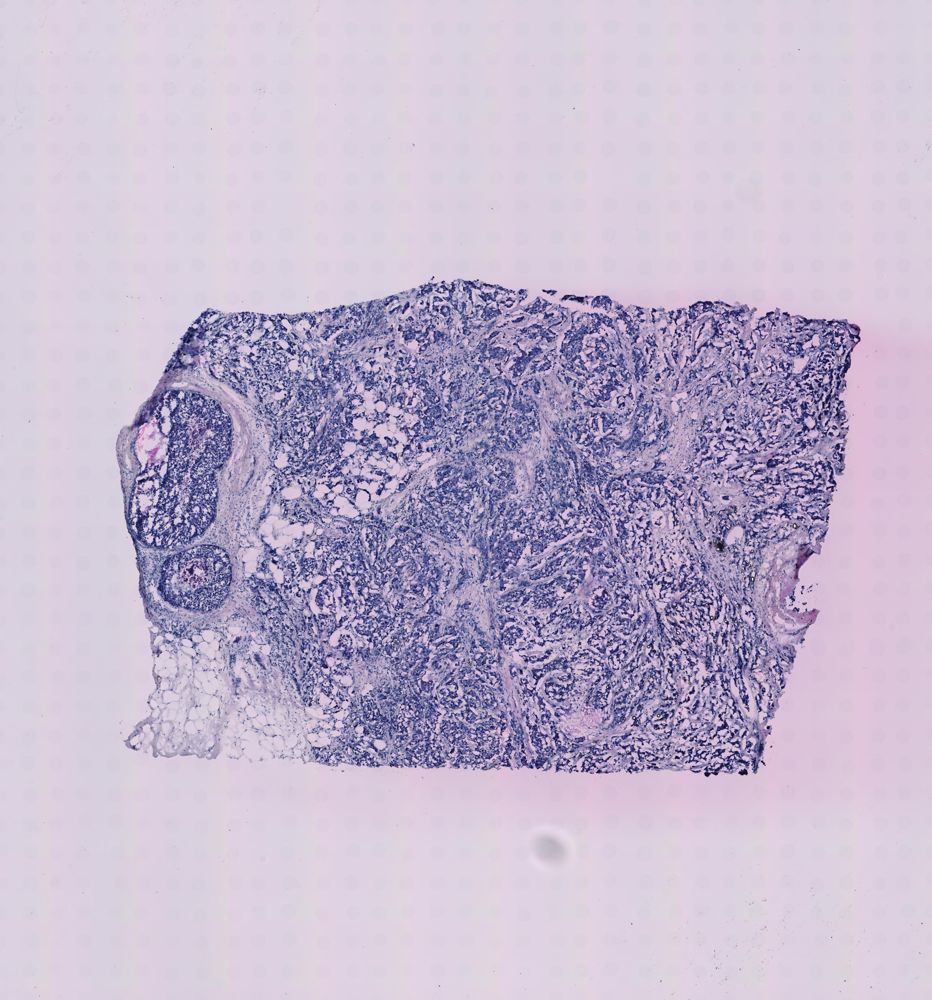

...

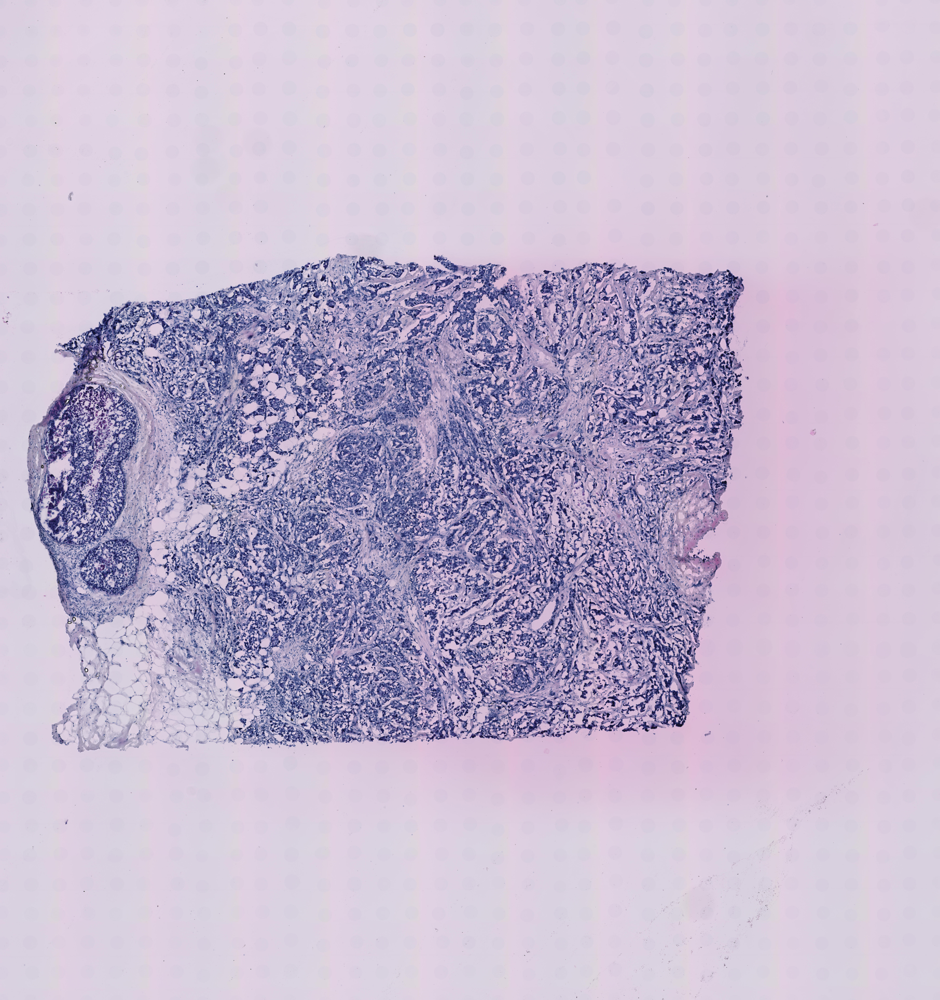

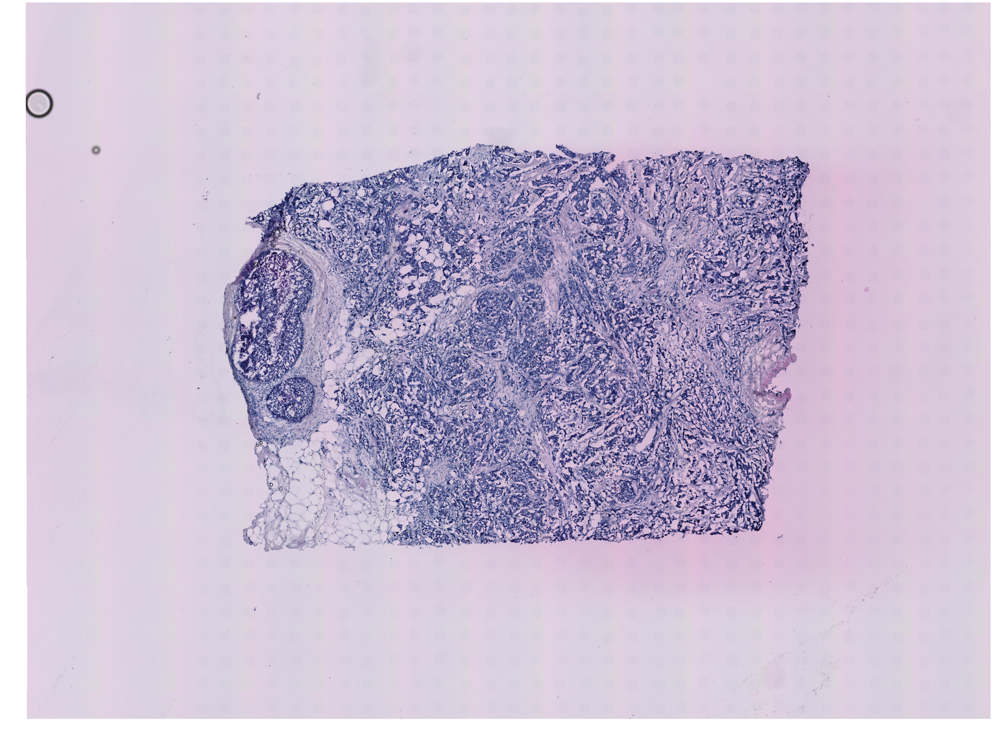

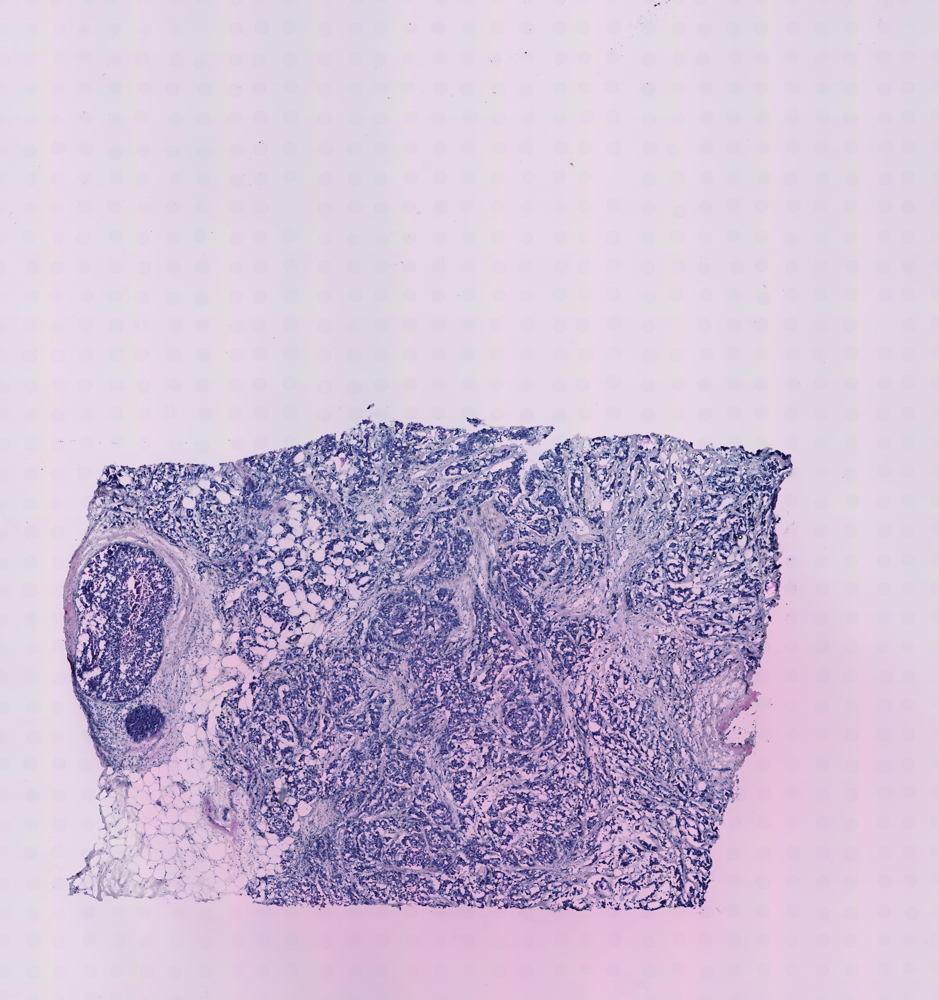

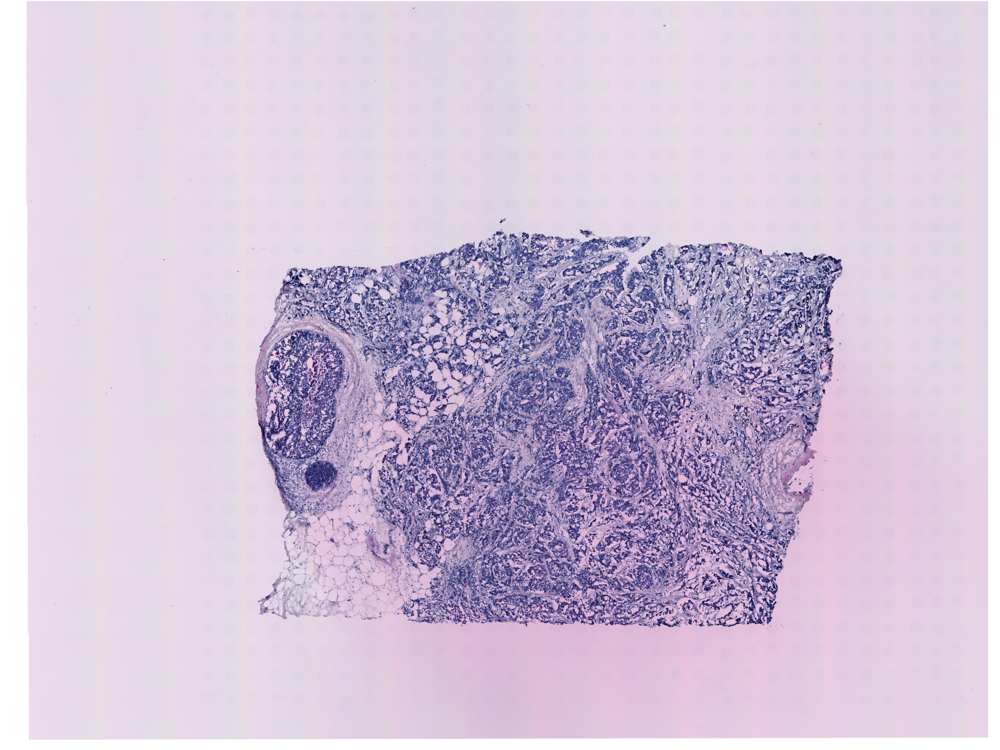

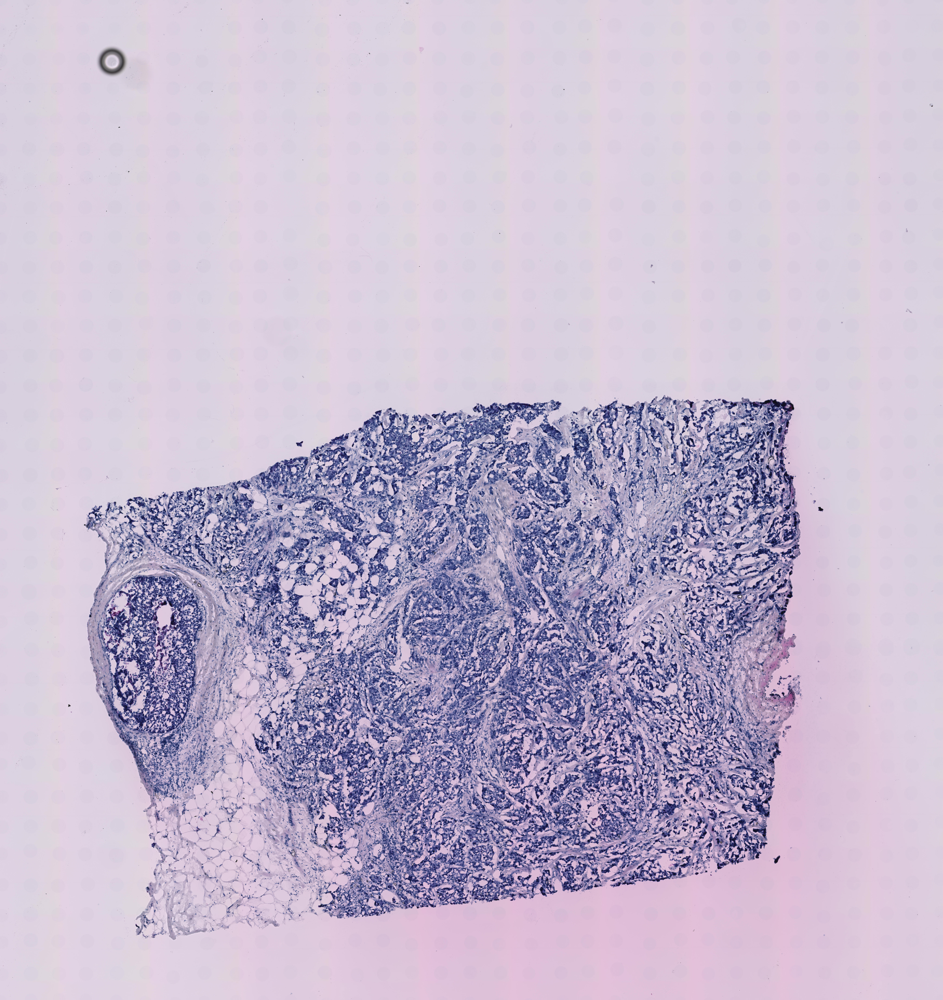

KeyboardInterrupt: 

In [61]:
for sample in sample_id_new:
    img_low = img_lowres_new_path / "{}_HE.jpg".format(sample)
    img_high = img_path / "{}_HE.jpg".format(sample)
    
    im_low = Image.open(img_low)
    im_high = Image.open(img_high)
    size_f0 = im_high.size[0] / im_low.size[0]
    size_f1 = im_high.size[1] / im_low.size[1]
    display(thumbnail(im_low))
    display(thumbnail(im_high))
#     print(size_f0, size_f1)

Added tissue image to the object!


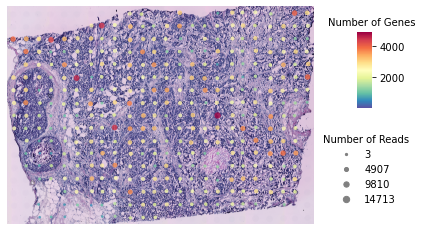

Added tissue image to the object!


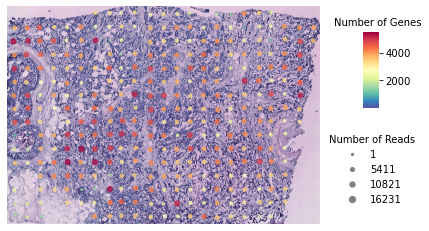

Added tissue image to the object!


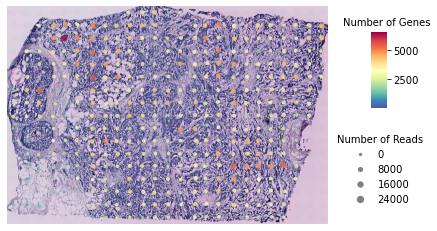

Added tissue image to the object!


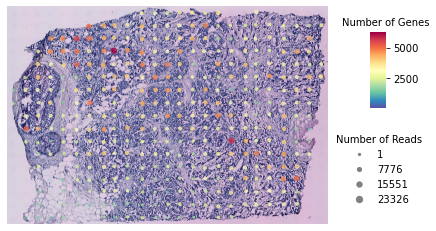

Added tissue image to the object!


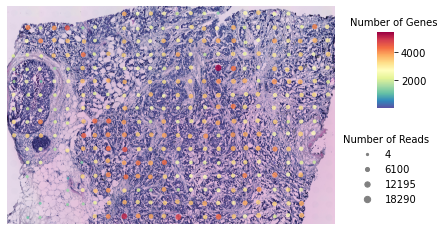

Added tissue image to the object!


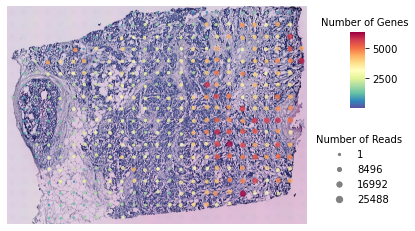

Added tissue image to the object!


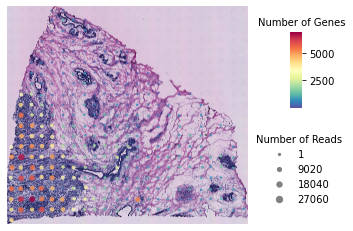

Added tissue image to the object!


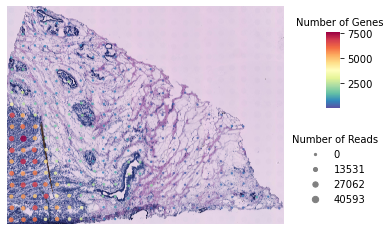

Added tissue image to the object!


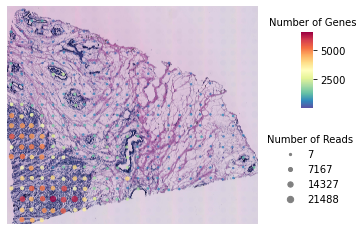

Added tissue image to the object!


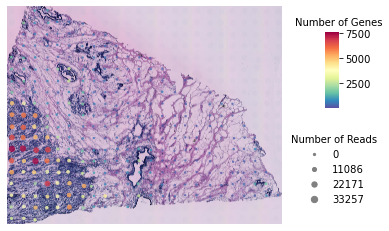

Added tissue image to the object!


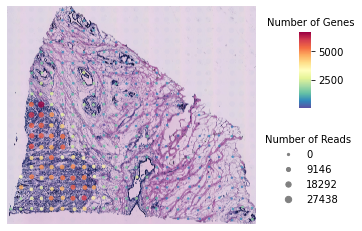

Added tissue image to the object!


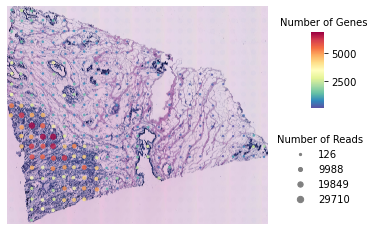

Added tissue image to the object!


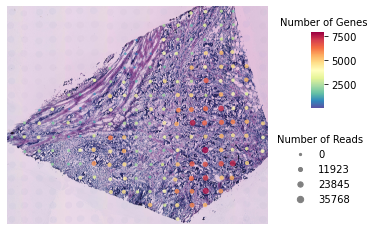

Added tissue image to the object!


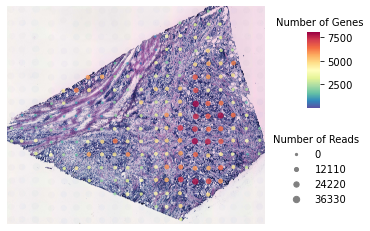

Added tissue image to the object!


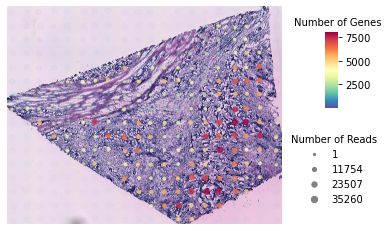

Added tissue image to the object!


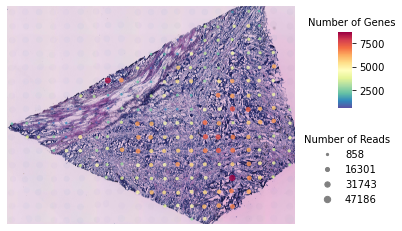

Added tissue image to the object!


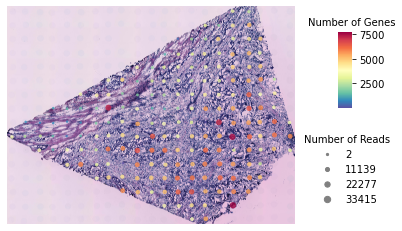

Added tissue image to the object!


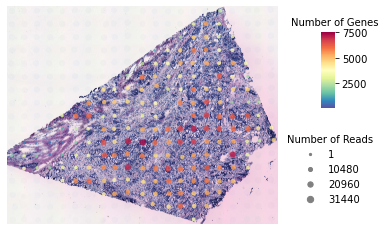

Added tissue image to the object!


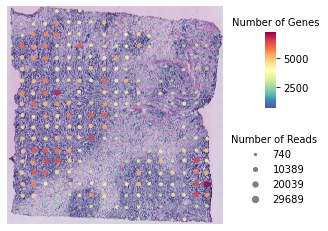

Added tissue image to the object!


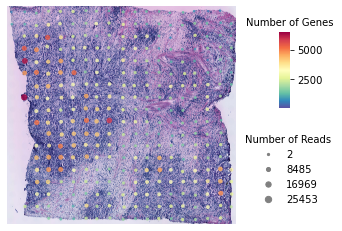

Added tissue image to the object!


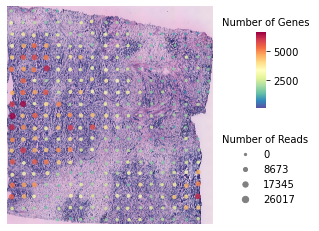

Added tissue image to the object!


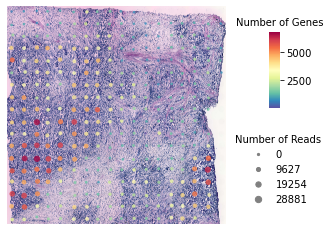

Added tissue image to the object!


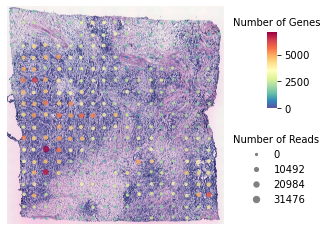

Added tissue image to the object!


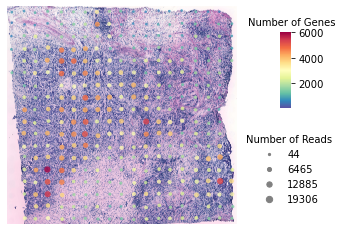

Added tissue image to the object!


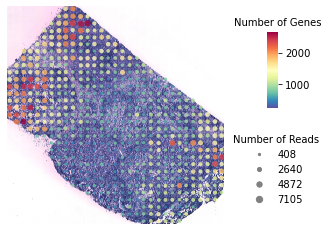

Added tissue image to the object!


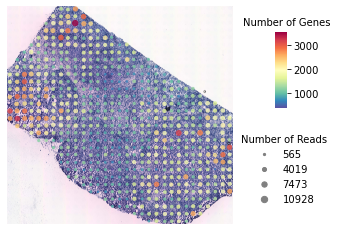

Added tissue image to the object!


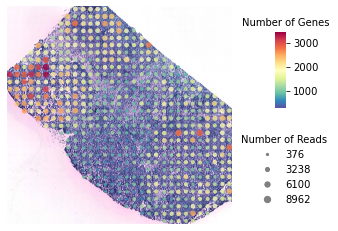

Added tissue image to the object!


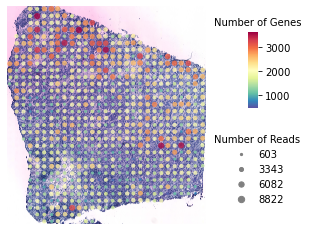

Added tissue image to the object!


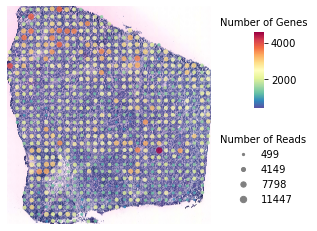

Added tissue image to the object!


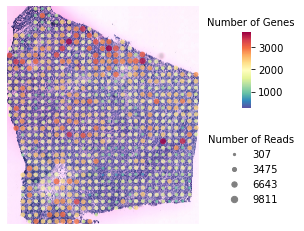

Added tissue image to the object!


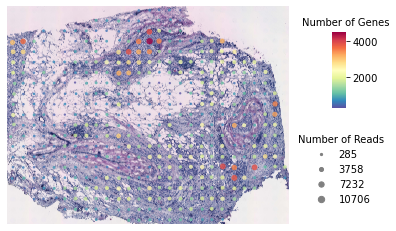

Added tissue image to the object!


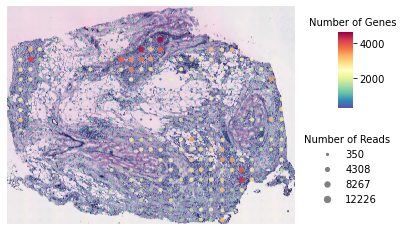

Added tissue image to the object!


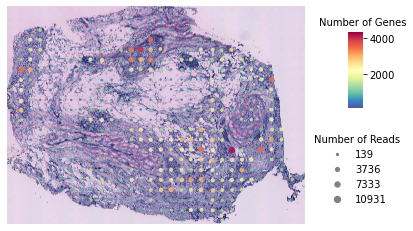

Added tissue image to the object!


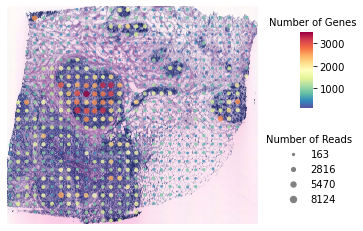

Added tissue image to the object!


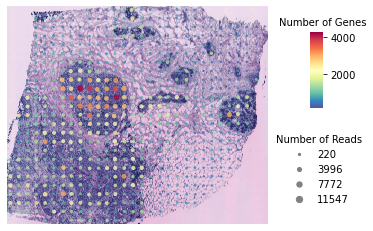

Added tissue image to the object!


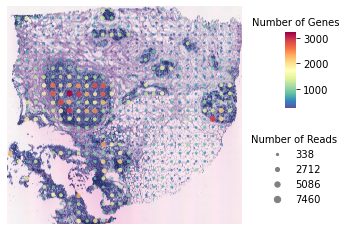

In [45]:
for sample in sample_id_new:
    cm = cm_path / "{}.tsv".format(sample)
    spot = spot_path / "{}_selection.tsv".format(sample)
#     img = img_path / "{}_HE.jpg".format(sample)
    img = img_lowres_new_path / "{}_HE.jpg".format(sample)
    data = st.ReadOldST(count_matrix_file = cm,
                        spatial_file = spot,
                        image_file = img)
    st.pl.QC_plot(data, dpi=150)